<a href="https://colab.research.google.com/github/sissilin1027/Deep_Learning-/blob/main/Music_Generation_with_Recurrent_Neural_Network.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
%tensorflow_version 2.x
import tensorflow as tf

!pip install mitdeeplearning
import mitdeeplearning as mdl

import numpy as np
import os
import time
import functools
from IPython import display as ipythondisplay
from tqdm import tqdm
!apt-get install abcmidi timidity > /dev/null 2>&1

assert len(tf.config.list_physical_devices('GPU')) > 0

     |████████████████████████████████| 2.1MB 2.8MB/s 
  Created wheel for mitdeeplearning: filename=mitdeeplearning-0.1.2-cp36-none-any.whl size=2114585 sha256=1a5ad9f72f9cab6e0d7a0a232a999060e2163e0bf7e801413fb235124522c934
  Stored in directory: /root/.cache/pip/wheels/27/e1/73/5f01c787621d8a3c857f59876c79e304b9b64db9ff5bd61b74
Successfully built mitdeeplearning


In [ ]:
#download the dataset

songs = mdl.lab1.load_training_data()

example_song = songs[0]
print("\nExample song: ")
print(example_song)


Found 816 songs in text

Example song: 
X:2
T:An Buachaill Dreoite
Z: id:dc-hornpipe-2
M:C|
L:1/8
K:G Major
GF|DGGB d2GB|d2GF Gc (3AGF|DGGB d2GB|dBcA F2GF|!
DGGB d2GF|DGGF G2Ge|fgaf gbag|fdcA G2:|!
GA|B2BG c2cA|d2GF G2GA|B2BG c2cA|d2DE F2GA|!
B2BG c2cA|d^cde f2 (3def|g2gf gbag|fdcA G2:|!


In [ ]:
#convert the ABC notation to audio file and listen to it

mdl.lab1.play_song(example_song)

In [ ]:
#join our list of song strings into a single string containing all songs
songs_joined = "\n\n".join(songs)

#find all unique characters in the joined string
vocab = sorted(set(songs_joined))

print("There are", len(vocab), "unique characters in the dataset")

There are 83 unique characters in the dataset


Process the dataset for the learning task


Given a character, or a sequence of characters, what is the most probable next character? We will train the model to perform this task.

To achieve this, we will input a sequence of characters to the model, and train the model to predict the output, that is, the following character at each time step. RNNs maintain an internal state that depends on previsouly seen elements, so information about all characters seen up until a given moment will be taken into account in generating the prediction. 



<strong>Vectorize the text</strong>





Before training RNN model, we will need to create a numerical representation of our text-based dataset. We will generate two lookup tables: one that maps characters to numbers, and a second that maps numbers back to characters. Recall that we just identified the unique characters present in the text


In [ ]:
#Define numerical representation of text

#create a mapping from character to unique index.
char2idx = {u:i for i, u in enumerate(vocab)}

#create a mapping from indices to characters. 
#This is the inverse of char2idx and allows us to convert back
#from unique index to the character in our vocab
idx2char = np.array(vocab)

In [ ]:
print('{')
for char, _ in zip(char2idx, range(20)):
  print(' {:4s}: {:3d},'.format(repr(char), char2idx[char]))
print(' ...\n}')

{
 '\n':   0,
 ' ' :   1,
 '!' :   2,
 '"' :   3,
 '#' :   4,
 "'" :   5,
 '(' :   6,
 ')' :   7,
 ',' :   8,
 '-' :   9,
 '.' :  10,
 '/' :  11,
 '0' :  12,
 '1' :  13,
 '2' :  14,
 '3' :  15,
 '4' :  16,
 '5' :  17,
 '6' :  18,
 '7' :  19,
 ...
}


In [ ]:
#Vectorize the songs string

def vectorize_string(string):
  vectorized_output = np.array([char2idx[char] for char in string])
  return vectorized_output

vectorized_songs = vectorize_string(songs_joined)

In [ ]:
print('{} ---- characters mapped to int ----{}'.format(repr(songs_joined[:10]), vectorized_songs[:10]))

assert isinstance(vectorized_songs, np.ndarray), "returned result should be a numpy array"

'X:2\nT:An B' ---- characters mapped to int ----[49 22 14  0 45 22 26 69  1 27]


Create training examples and targets

Our next step is to actually divide the text into example sequences that we will use during training. Each input sequence that we feed into our RNN will contain seq_length characters from the text. We will also need to define a target sequence for each input sequence, which will be used in training the RNN to predict the next character. For each input, the corresponding target will contain the same length of text, except shifted one character to the right.

To do this, we'll break the text into chunks of seq_length+1. Suppose seq_length is 4 and our text is "Hello". Then, our input sequence is "Hell" and the target sequence is "ello".

The batch method will then let us convert this stream of character indices to sequences of the desired size.

In [ ]:
#Batch definition to create training examples

def get_batch(vectorized_songs, seq_length, batch_size):
  #the lenght of the vectorized songs string
  n = vectorized_songs.shape[0] - 1
  #randomly choose the starting indices for the examples in the training batch
  idx = np.random.choice(n-seq_length, batch_size)

  input_batch = [vectorized_songs[i: i+seq_length] for i in idx]
  output_batch = [vectorized_songs[i+1 : i+seq_length+1] for i in idx]

  # x_batch, y_batch provide the true inputs and targets for network training
  x_batch = np.reshape(input_batch, [batch_size, seq_length])
  y_batch = np.reshape(output_batch, [batch_size, seq_length])
  return x_batch, y_batch

test_args = (vectorized_songs, 10, 2)
if not mdl.lab1.test_batch_func_types(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_shapes(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_next_step(get_batch, test_args):
   print("=====\n[FAIL] Could not pass tests")

else:
   print("=====\n[PASS] passed all the tests!")

[PASS] test_batch_func_types
[PASS] test_batch_func_shapes
[PASS] test_batch_func_next_step
=====
[PASS] passed all the tests!


For each of these vectors, each index is processed at a single time step. For the input at time step 0, the model receives the index for the first character in the sequence, and tries to predict the index of the next character. At the next timestep, it does the same thing, but the RNN considers the information from the previous step, ie, its updated state, in addition to the current input.

We can make this concrete by taking a look at how this works over the first several characters in our text

In [ ]:
x_batch, y_batch = get_batch(vectorized_songs, seq_length=5, batch_size=1)

for i, (input_idx, target_idx) in enumerate(zip(np.squeeze(x_batch), np.squeeze(y_batch))):
    print("Step {:3d}".format(i))
    print(" input: {} ({:s})".format(input_idx, repr(idx2char[input_idx])))
    print(" expected output: {} ({:s})".format(target_idx, repr(idx2char[target_idx])))
    

Step   0
 input: 82 ('|')
 expected output: 27 ('B')
Step   1
 input: 27 ('B')
 expected output: 58 ('c')
Step   2
 input: 58 ('c')
 expected output: 27 ('B')
Step   3
 input: 27 ('B')
 expected output: 1 (' ')
Step   4
 input: 1 (' ')
 expected output: 59 ('d')


The Recurrent Neural Network (RNN) model


We will define and train a RNN model on our ABC music dataset, and then use the trained model to generate a new song. We will train our RNN using batches of songs snippets from our dataset, which we generated in the previous section.

The model is based off the LSTM architecture, where we use a state vector to maintain information about the temporal relationships between consecutive characters. The final output of the LSTM is then fed into a fully conncected Dense layer where we will output a softmax over each character in the vocabulary, and then sample from this distribution to predict the next character. 

We will be using Keras API, specifically, tf.keras.Sequential, to define the model. Three layers are used to define the model:

<ul>tf.keras.layers.Embedding: This is the input layer, consisting of a trainable lookup table that maps the numbers of each character to a vector with embedding_dim dimensions.</ul>
<ul>tf.keras.layers.LSTM: Our LSTM network, with size units=rnn_units</ul>
<ul>tf.keras.layers.Dense: The output layer, with vocab_size outputs</ul>

In [ ]:
def LSTM(rnn_units):
  return tf.keras.layers.LSTM(
      rnn_units, 
      return_sequences=True, 
      recurrent_initializer='glorot_uniform',
      recurrent_activation='sigmoid',
      stateful=True,
  )

In [ ]:
#Defining the RNN model

def build_model(vocab_size, embedding_dim, rnn_units, batch_size):
  model = tf.keras.Sequential([
    #layer 1: embedding layer to transform indices into dense vectors of a fixed embedding size
    tf.keras.layers.Embedding(vocab_size, embedding_dim, batch_input_shape=[batch_size, None]),

    #layer 2: LSTM with 'rnn_units' number of units
    LSTM(rnn_units),

    #layer 3: Dense (fully connected) layer that transforms the LSTM output into the vocab size
    tf.keras.layers.Dense(vocab_size)
  ])

  return model

#build a simple model with default hyperparameters. You will get the chance to change it later
model = build_model(len(vocab), embedding_dim=256, rnn_units=1024, batch_size=32)

Test out the RNN model

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (32, None, 256)           21248     
_________________________________________________________________
lstm (LSTM)                  (32, None, 1024)          5246976   
_________________________________________________________________
dense (Dense)                (32, None, 83)            85075     
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


In [ ]:
x, y  = get_batch(vectorized_songs, seq_length=100, batch_size=32)
pred = model(x)

print("Input shape:      ", x.shape, " #(batch_size, sequence_length)")
print("Prediction shape: ", pred.shape, " #(batch_size, sequence_length, vocab_size)")

Input shape:       (32, 100)  #(batch_size, sequence_length)
Prediction shape:  (32, 100, 83)  #(batch_size, sequence_length, vocab_size)


<storng>Predictions from the untrained model</strong>

To get actual predictions from the model, we sample from the output distribution, which is defined by a softmax over our character vocabulary. This will give us actual character indices. This means we are using a categorical distribution to sample over the example prediction. This gives a prediction of the next character (specifically its index) at each timestep. 

Note here that we sample from this probability distribution, as opposed to simply taking the argmax, which can cause the model to get stuck in a loop.


In [ ]:
sampled_indices = tf.random.categorical(pred[0], num_samples=1)
sampled_indices = tf.squeeze(sampled_indices, axis=-1).numpy()
sampled_indices

array([15, 26, 70, 45,  4, 34,  1, 69, 69, 61, 55, 46, 27, 39,  4,  8, 39,
       58, 28, 69, 64, 15, 76, 70, 27, 52, 15, 49, 18, 54, 51, 70, 81, 14,
       26, 37, 75, 78, 33, 57, 26,  7, 42, 74, 46, 46, 66, 29, 24, 64, 69,
       65, 24, 51, 50, 41, 61, 40, 38, 42, 36, 47, 69, 52,  5, 62, 27, 21,
       13,  4, 73, 32, 40, 80, 37, 82, 18, 48, 70, 47, 12, 76, 12, 33,  4,
       13, 39, 49, 65, 45,  8, 53, 58,  4, 81, 73, 79, 53, 27, 73])

In [ ]:
print("Input: \n", repr("".join(idx2char[x[0]])))
print()
print("Next Char Predictions: \n", repr("".join(idx2char[sampled_indices])))

Input: 
 'd:dc-reel-236\nM:C\nL:1/8\nK:G Major\nD|G2BG EGDC|B,DGB AGAB|c2ec B2dB|cABG AGED|!\nG2BG EGDC|B,DGB AGAB|'

Next Char Predictions: 
 "3AoT#I nnf_UBN#,NcCni3uoB[3X6^Zoz2ALtwHbA)QsUUkD=inj=ZYPfOMQKVn['gB91#rGOyL|6WoV0u0H#1NXjT,]c#zrx]Br"


<strong>Training the model: loss and training operations</strong>

We can think of our next character prediction problem as a standard classification problem. Given the previous state of the RNN, as well as the input at a given time step, we want to predict the class of the next character, to actually predict the next character. 

To train our model on this classification task, we can use a form of the crossentropy loss (negative log likelihood loss). Specifically, we will use the sparse_categorical_crossentropy loss, as it utilizes integer targets for categorical classification tasks. We will want to compute the loss using the true targets - the labels - and the predicted targets - the logits.



In [ ]:
def compute_loss(labels, logits):
  loss = tf.keras.losses.sparse_categorical_crossentropy(labels, logits, from_logits=True)
  return loss

example_batch_loss = compute_loss(y, pred)

print("Prediction shape: ", pred.shape, " # (batch_size, sequence_length, vocab_size)")
print("scalar_loss:      ", example_batch_loss.numpy().mean())

Prediction shape:  (32, 100, 83)  # (batch_size, sequence_length, vocab_size)
scalar_loss:       4.4194417


In [ ]:
# Hyperparameter setting and optimization

#optimization parameters:
num_training_iterations = 2000
batch_size = 4
seq_length = 100
learning_rate = 5e-3

#model parameters
vocab_size = len(vocab)
embedding_dim = 256
rnn_units = 1024

#checkpoint location
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "my_ckpt")

First, we will instantiate a new model and an optimizer. Then we will use the tf.GradientTape method to perform the backpropogation operations. 

We will also generate a print-out of the model's progress through training, which will help us easily visualize whether or not we are minimizing the loss

In [ ]:
# Define the optimizer and training operation

model = build_model(vocab_size, embedding_dim, rnn_units, batch_size)

optimizer = tf.keras.optimizers.Adam(learning_rate)

@tf.function
def train_step(x, y):
  with tf.GradientTape() as tape:
    y_hat = model(x)
    loss = compute_loss(y, y_hat)

  grads = tape.gradient(loss, model.trainable_variables)

  #apply the gradients to the optimizer so it can update the model accordingly
  optimizer.apply_gradients(zip(grads, model.trainable_variables))
  return loss

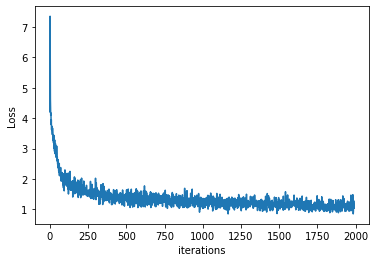

100%|██████████| 2000/2000 [00:47<00:00, 42.21it/s]


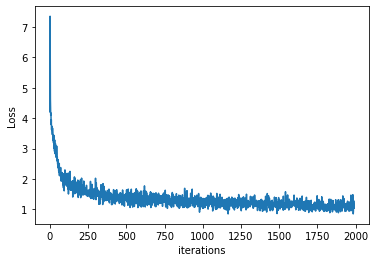

In [ ]:
history = []
plotter = mdl.util.PeriodicPlotter(sec=2, xlabel='iterations', ylabel='Loss')
if hasattr(tqdm, '_instances'): tqdm._instances.clear()

for iter in tqdm(range(num_training_iterations)):
    
    # grab a batch and propogate it through the network
    x_batch, y_batch = get_batch(vectorized_songs, seq_length, batch_size)
    loss = train_step(x_batch, y_batch)

    #update the progress bar
    history.append(loss.numpy().mean())
    plotter.plot(history)

    #update the model with the changed weights
    if iter % 100 == 0:
      model.save_weights(checkpoint_prefix)

#save the trained model and the weights
model.save_weights(checkpoint_prefix)


<strong>Generate music using the RNN model</strong>


We can use our trained RNN model to generate some music. When generating music, we will have to feed the model some sort of seed to get it started.

Once we have a generated seed, we can then iteratively predict each successive character using our trained RNN. More specifically, recall that our RNN outputs a softmax over possible successive characters. For inference, we iteratively sample from these distributions, and then use our samples to encode a genereated song in the ABC format.

<strong>Restore the latest checkpoint</strong>

To keep this inference step simple, we will use a batch size of 1. Because of how the RNN state is passed from timestep to timestep, the model will only be able to accept a fixed batch size once it is built.

To run the model with a different batch_size, we will need to rebuild the model and restore the weights from the latest checkpoint.


In [ ]:
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size=1)

model.load_weights(tf.train.latest_checkpoint(checkpoint_dir))
model.build(tf.TensorShape([1, None]))

model.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_3 (Embedding)      (1, None, 256)            21248     
_________________________________________________________________
lstm_3 (LSTM)                (1, None, 1024)           5246976   
_________________________________________________________________
dense_3 (Dense)              (1, None, 83)             85075     
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


<strong>The prediction procedure</strong>


<ol>Initialize a "seed" start string and the RNN state, and set the number of characters we want to generate</ol>
<ol>Use the start string and the RNN state to obtain the probablity distribution over the next predicted character.</ol>
<ol>Sample from multinomial distribution to calculate the index of the predicted character. This predicted character is then used as the next input to the model</ol>
<ol>At each time step, the updated RNN state is fed back into the model, so that it now has more context in making the next prediction. After predicting the next character, the updated RNN states are again fed back into the model, which is how it learns sequence dependencies in the data, as it gets more information from the previous predictions.</ol>


In [ ]:
# Prediction of a generated song

def generate_text(model, start_string, generation_length=1000):
  #evaluation step (generating ABC text using the learned RNN model)

  input_eval = [char2idx[s] for s in start_string]
  input_eval = tf.expand_dims(input_eval, 0)

  #empty string to store our results
  text_generated=[]

  #batch size == 1
  model.reset_states()
  tqdm._instances.clear()

  for i in tqdm(range(generation_length)):
    # evaluate the inputs and generate the next character predictions
    predictions = model(input_eval)

    #remove the batch dimension
    predictions = tf.squeeze(predictions, 0)

    #use a multinomial distribution to sample
    predicted_id = tf.random.categorical(predictions, num_samples=1)[-1, 0].numpy()

    #pass the prediction along with the previous hidden state as the next inputs to the model
    input_eval = tf.expand_dims([predicted_id], 0)

    #add the predicted character to the generated text
    text_generated.append(idx2char[predicted_id])

  return (start_string + "".join(text_generated))

In [ ]:
#use the model and the function defined above to generate ABC format text of lengthh 1000
generated_text = generate_text(model, start_string='X', generation_length=1000)

100%|██████████| 1000/1000 [00:04<00:00, 241.55it/s]


In [ ]:
# Playback the generated music

generated_songs = mdl.lab1.extract_song_snippet(generated_text)

for i, song in enumerate(generated_songs):
  #synthesize the waveform from a song
  waveform = mdl.lab1.play_song(song)

  if waveform:
    print("Generated song", i)
    ipythondisplay.display(waveform)

Found 1 songs in text
Generated song 0
